## 登月图片消噪

scipy.fftpack模块用来计算快速傅里叶变换  
速度比传统傅里叶变换更快，是对之前算法的改进  
图片是二维数据，注意使用fftpack的二维转变方法

In [ ]:
# 所有的函数多可以使用正弦波表示,所有函数都可以表示成多个正弦波叠加（多项式）
# 傅里叶变换复杂的数据转换成单一的数据
# 时域 -------> 频域

In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

In [4]:
import numpy as np
img = np.zeros(shape = (300,400,3),dtype = np.uint8)
img

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

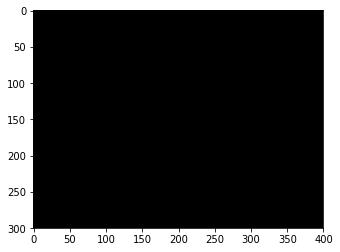

In [5]:
# 数据没有波动
plt.imshow(img)

In [6]:
moon = plt.imread('./moonlanding.png')
moon

array([[0.04705882, 0.        , 0.23921569, ..., 0.        , 0.00392157,
        0.53333336],
       [0.        , 0.        , 0.6784314 , ..., 0.10196079, 0.2901961 ,
        0.        ],
       [0.72156864, 0.10980392, 0.6039216 , ..., 0.        , 0.21568628,
        1.        ],
       ...,
       [0.00392157, 0.        , 1.        , ..., 1.        , 1.        ,
        0.95686275],
       [0.        , 0.        , 0.15686275, ..., 0.        , 0.        ,
        0.3529412 ],
       [1.        , 0.52156866, 0.04705882, ..., 0.        , 0.        ,
        1.        ]], dtype=float32)

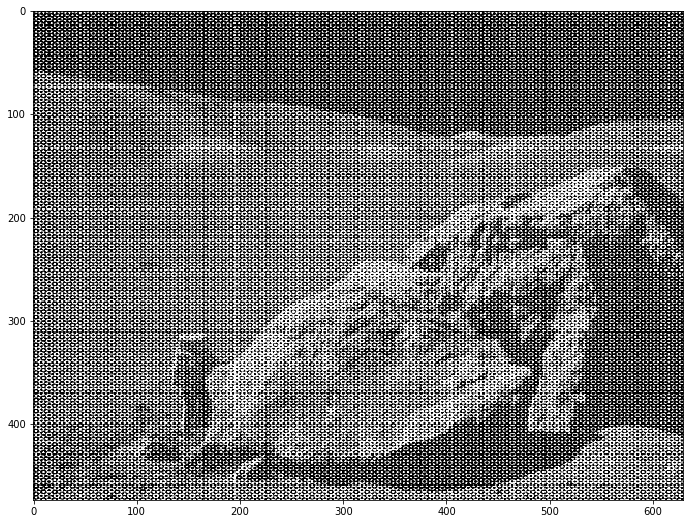

In [13]:
plt.figure(figsize=(12,9))
''' Accent, Accent_r, Blues, Blues_r, BrBG, BrBG_r, BuGn, BuGn_r, BuPu, BuPu_r, CMRmap,
CMRmap_r, Dark2, Dark2_r, GnBu, GnBu_r, Greens, Greens_r, Greys, Greys_r, OrRd, OrRd_r, Oranges, Oranges_r, 
PRGn, PRGn_r, Paired, Paired_r, Pastel1, Pastel1_r, Pastel2, Pastel2_r, PiYG, PiYG_r, PuBu, PuBuGn, PuBuGn_r, PuBu_r, PuOr, PuOr_r, PuRd, PuRd_r, Purples, Purples_r, RdBu, RdBu_r, RdGy, RdGy_r, RdPu, RdPu_r, RdYlBu, RdYlBu_r, RdYlGn, RdYlGn_r, Reds, Reds_r, Set1, Set1_r, Set2, Set2_r, Set3, Set3_r, Spectral, Spectral_r, Wistia, Wistia_r, YlGn, YlGnBu, YlGnBu_r, YlGn_r, YlOrBr, YlOrBr_r, YlOrRd, YlOrRd_r, afmhot, afmhot_r, autumn, autumn_r, binary, binary_r, bone, bone_r, brg, brg_r, bwr, bwr_r, cividis, cividis_r, cool, cool_r, coolwarm, coolwarm_r, copper, copper_r, cubehelix, cubehelix_r, flag, flag_r, gist_earth, gist_earth_r, gist_gray, gist_gray_r, gist_heat, gist_heat_r, gist_ncar, gist_ncar_r, gist_rainbow, gist_rainbow_r, gist_stern, gist_stern_r, gist_yarg, gist_yarg_r, gnuplot, gnuplot2, gnuplot2_r, gnuplot_r, gray, gray_r, hot, hot_r, hsv, hsv_r, inferno, inferno_r, jet, jet_r, magma, magma_r, nipy_spectral, nipy_spectral_r, ocean, ocean_r, pink, pink_r, plasma, plasma_r, prism, prism_r, rainbow, rainbow_r, seismic, seismic_r, spring, spring_r, summer, summer_r, tab10, tab10_r,
tab20, tab20_r, tab20b, tab20b_r, tab20c, tab20c_r, terrain, terrain_r, viridis, viridis_r, winter, winter_r'''
plt.imshow(moon,cmap = 'gray')

In [ ]:
# 图片中噪声点：白色的圆环
# 圆环上的数据和圆环里面和外面不同，所以肉眼显示出来
# 波动
# 噪声的地方，波动比较大

In [14]:
# 傅里叶变换数据-------> 频域（数据波动情况）
# 将波动比较大的数据过滤掉，噪声过滤

import scipy.fftpack as fftpact

In [15]:
# 1、将时域（真实数据moon）----->频域
moon_fft = fftpact.fft2(moon)
# 实数 + 虚数
# x** = 4 --->正负二
# x** = -4 ---->虚数
moon_fft

array([[126598.45      +0.j       ,  -4608.5796 -1892.4688j   ,
          -322.093    -20.27744j  , ...,   -906.1585 +1539.3081j   ,
          -322.093    +20.27744j  ,  -4608.5796 +1892.4688j   ],
       [ -9421.1    +5242.1133j   ,   5224.016  -3171.7434j   ,
          1607.9927 +1269.4243j   , ...,   -677.34503 -936.16174j  ,
           354.6247 -1003.8348j   ,   1965.366  -2188.0593j   ],
       [ -2928.3513 +7280.916j    ,  -1116.4065 +1338.3179j   ,
          -474.20056 +385.40216j  , ...,    239.7723  -977.2129j   ,
          1582.9283  -261.95346j  ,   2641.927   -292.09366j  ],
       ...,
       [  1850.5718 -2451.1787j   ,   -781.0807   +13.744501j ,
           377.90707  +12.6699295j, ...,  -1526.7869 +1271.2621j   ,
         -2705.5718 -3488.529j    ,   1897.404  -2281.9092j   ],
       [ -2928.3513 -7280.916j    ,   2641.927   +292.09366j  ,
          1582.9283  +261.95346j  , ...,  -2208.4302   +81.807434j ,
          -474.20056 -385.40216j  ,  -1116.4065 -1338.3179j   ]

In [17]:
np.abs(moon_fft).mean()

51.193375

In [18]:
moon_fft

array([[126598.45      +0.j       ,  -4608.5796 -1892.4688j   ,
          -322.093    -20.27744j  , ...,   -906.1585 +1539.3081j   ,
          -322.093    +20.27744j  ,  -4608.5796 +1892.4688j   ],
       [ -9421.1    +5242.1133j   ,   5224.016  -3171.7434j   ,
          1607.9927 +1269.4243j   , ...,   -677.34503 -936.16174j  ,
           354.6247 -1003.8348j   ,   1965.366  -2188.0593j   ],
       [ -2928.3513 +7280.916j    ,  -1116.4065 +1338.3179j   ,
          -474.20056 +385.40216j  , ...,    239.7723  -977.2129j   ,
          1582.9283  -261.95346j  ,   2641.927   -292.09366j  ],
       ...,
       [  1850.5718 -2451.1787j   ,   -781.0807   +13.744501j ,
           377.90707  +12.6699295j, ...,  -1526.7869 +1271.2621j   ,
         -2705.5718 -3488.529j    ,   1897.404  -2281.9092j   ],
       [ -2928.3513 -7280.916j    ,   2641.927   +292.09366j  ,
          1582.9283  +261.95346j  , ...,  -2208.4302   +81.807434j ,
          -474.20056 -385.40216j  ,  -1116.4065 -1338.3179j   ]

In [20]:
# 2、将波动比较大的数据过滤掉，设置为0
# 临界值500 大于500 波动情况比较大，过滤掉

cond = np.abs(moon_fft) > 500

moon_fft[cond] = 0
moon_fft

array([[   0.      +0.j       ,    0.      +0.j       ,
        -322.093  -20.27744j  , ...,    0.      +0.j       ,
        -322.093  +20.27744j  ,    0.      +0.j       ],
       [   0.      +0.j       ,    0.      +0.j       ,
           0.      +0.j       , ...,    0.      +0.j       ,
           0.      +0.j       ,    0.      +0.j       ],
       [   0.      +0.j       ,    0.      +0.j       ,
           0.      +0.j       , ...,    0.      +0.j       ,
           0.      +0.j       ,    0.      +0.j       ],
       ...,
       [   0.      +0.j       ,    0.      +0.j       ,
         377.90707+12.6699295j, ...,    0.      +0.j       ,
           0.      +0.j       ,    0.      +0.j       ],
       [   0.      +0.j       ,    0.      +0.j       ,
           0.      +0.j       , ...,    0.      +0.j       ,
           0.      +0.j       ,    0.      +0.j       ],
       [   0.      +0.j       ,    0.      +0.j       ,
           0.      +0.j       , ...,    0.      +0.j       ,
 

In [23]:
# 3、频域------>时域（数据）

moon_result = fftpact.ifft2(moon_fft)
moon_result

moon_result = np.real(moon_result)
moon_result

array([[-0.2158841 ,  0.08547963, -0.17341562, ...,  0.00313992,
        -0.1262884 , -0.12006474],
       [-0.07464715,  0.02630262, -0.05795981, ..., -0.10645279,
        -0.10607974, -0.06213436],
       [ 0.01300102, -0.04392404, -0.03069701, ..., -0.09355526,
        -0.09281505,  0.0542773 ],
       ...,
       [ 0.00554965, -0.06839301, -0.11348293, ...,  0.05521014,
        -0.02254207,  0.17004317],
       [-0.0236596 , -0.21761242, -0.04112267, ..., -0.03240317,
        -0.03881308,  0.18942517],
       [-0.06233123,  0.06238206, -0.05904231, ..., -0.05108529,
        -0.01733968, -0.04830741]], dtype=float32)

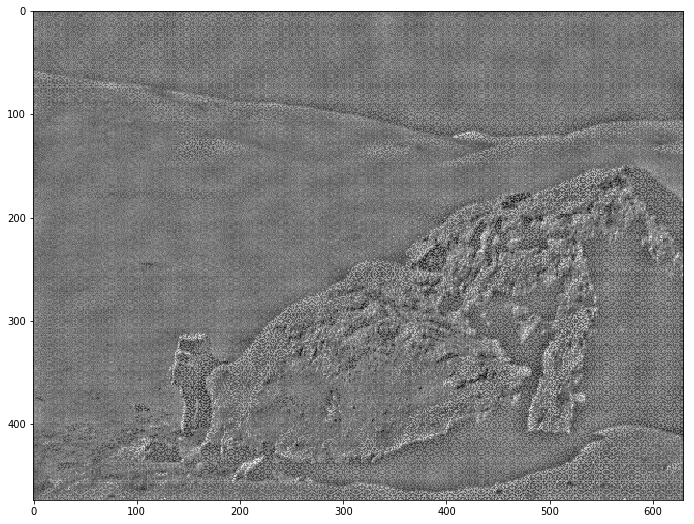

In [24]:
plt.figure(figsize=(12,9))
plt.imshow(moon_result,cmap = 'gray')

### 数值积分，求解圆周率
求解圆周率  

integrate
对函数(1 - x^2)^0.5进行积分 

In [25]:
# s = pi*r**2
# r = 1
# s = pi
# 求解圆的面积------>圆周率

In [26]:
x = np.linspace(-1,1,200)

In [27]:
# y = (1 - X**2)**0.5

y = (1 - x**2)**0.5

In [31]:
y

array([0.        , 0.14141957, 0.19949179, 0.24370564, 0.28068824,
       0.3130133 , 0.34200401, 0.3684483 , 0.39286071, 0.41559946,
       0.43692593, 0.45703787, 0.47608922, 0.49420265, 0.51147782,
       0.52799701, 0.54382912, 0.55903252, 0.57365721, 0.58774639,
       0.6013377 , 0.61446418, 0.62715501, 0.63943613, 0.65133072,
       0.6628596 , 0.67404151, 0.68489347, 0.69543091, 0.70566793,
       0.71561741, 0.7252912 , 0.73470018, 0.74385439, 0.75276315,
       0.76143505, 0.76987811, 0.77809977, 0.78610699, 0.79390624,
       0.8015036 , 0.80890476, 0.81611506, 0.82313951, 0.82998283,
       0.83664946, 0.84314361, 0.84946921, 0.85563002, 0.86162956,
       0.86747118, 0.87315806, 0.87869319, 0.88407942, 0.88931947,
       0.8944159 , 0.89937115, 0.90418754, 0.90886729, 0.91341248,
       0.91782513, 0.92210713, 0.92626029, 0.93028635, 0.93418694,
       0.93796363, 0.9416179 , 0.94515119, 0.94856484, 0.95186014,
       0.95503831, 0.95810053, 0.96104789, 0.96388145, 0.96660

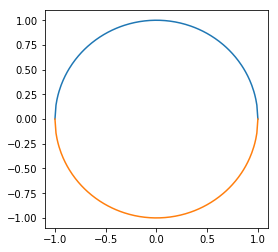

In [30]:
# plot绘制
plt.figure(figsize=(4,4))
plt.plot(x,y)
plt.plot(x,-y)

In [32]:
f = lambda x :(1 - x**2)**0.5
type(f)

function

X**2 + Y**2 = 1,半径是1  
pi×r**2,只要求得面积--->pi

首先画一个圆

圆的面积是？

使用scipy.integrate进行积分，调用quad()方法

In [33]:
import scipy.integrate as integrate

In [35]:
ret,err = integrate.quad(f,-1,1)

In [36]:
print('使用积分求解的圆周率：%s；误差是：%s'%(str(ret*2),str(err)))

使用积分求解的圆周率：3.141592653589797；误差是：1.0002356720661965e-09


### Scipy文件输入/输出


随机生成数组，使用scipy中的io.savemat()保存  
文件格式是.mat，标准的二进制文件

In [37]:
import scipy.io

In [38]:
scipy.io.savemat('./data.mat',mdict={'moon':moon,'moon_result':moon_result})

使用io.loadmat()读取数据

In [39]:
# mat martix 矩阵
data = scipy.io.loadmat('./data.mat')
data

{'__header__': b'MATLAB 5.0 MAT-file Platform: nt, Created on: Mon Jul 16 10:27:22 2018',
 '__version__': '1.0',
 '__globals__': [],
 'moon': array([[0.04705882, 0.        , 0.23921569, ..., 0.        , 0.00392157,
         0.53333336],
        [0.        , 0.        , 0.6784314 , ..., 0.10196079, 0.2901961 ,
         0.        ],
        [0.72156864, 0.10980392, 0.6039216 , ..., 0.        , 0.21568628,
         1.        ],
        ...,
        [0.00392157, 0.        , 1.        , ..., 1.        , 1.        ,
         0.95686275],
        [0.        , 0.        , 0.15686275, ..., 0.        , 0.        ,
         0.3529412 ],
        [1.        , 0.52156866, 0.04705882, ..., 0.        , 0.        ,
         1.        ]], dtype=float32),
 'moon_result': array([[-0.2158841 ,  0.08547963, -0.17341562, ...,  0.00313992,
         -0.1262884 , -0.12006474],
        [-0.07464715,  0.02630262, -0.05795981, ..., -0.10645279,
         -0.10607974, -0.06213436],
        [ 0.01300102, -0.04392404,

In [ ]:
# 图片数据：黑白的是二维的ndarray，彩色三维ndarray
# mp4;wav

In [40]:
from scipy.io import wavfile

In [42]:
# wav 音乐文件数据二维的ndarray
rate,love_data = wavfile.read('./邓紫棋-喜欢你.wav')

In [43]:
type(love_data)

numpy.ndarray

In [44]:
type(moon)

numpy.ndarray

In [ ]:
# 图片，音乐---------> ndarray

In [45]:
rate,jueji_data = wavfile.read('./林俊杰-爱不会绝迹.wav')
display(rate,jueji_data)

C:\Users\softpo.DESKTOP-PN692CT\Anaconda3\lib\site-packages\scipy\io\wavfile.py:273: WavFileWarning: Chunk (non-data) not understood, skipping it.
  WavFileWarning)


44100

array([[0, 0],
       [0, 0],
       [0, 0],
       ...,
       [0, 0],
       [0, 0],
       [0, 0]], dtype=int16)

In [48]:
2**16-1

65535

In [46]:
# 数据从-65536 ~ 65535
jueji_data.min()

-32401

In [47]:
jueji_data.max()

32399

In [49]:
display(jueji_data.shape,love_data.shape)

(10601648, 2)

(10776444, 2)

In [54]:
10776444/2

5388222.0

In [53]:
10601648/2

5300824.0

In [55]:
# 组合音乐
mix_music = np.concatenate([jueji_data[:5300824],love_data[5388222:]])

In [56]:
mix_music.shape

(10689046, 2)

In [57]:
wavfile.write('./mix_music.wav',44100,mix_music)

In [58]:
# 大部分音乐文件都是mp3格式，mp3格式压缩格式，大小大大降低

# scipy 没有提供mp3个文件的读取，所以使用pydub来获取mp3文件中的数据，并且可以多数据进行相应操作

import pydub


In [59]:
jing = pydub.AudioSegment.from_mp3('难念的经.mp3')
jing

In [60]:
data = jing.get_array_of_samples()

# 不要打印
type(data)

array.array

In [61]:
# 将array.array转换
jing_data = np.array(data.tolist())
jing_data.shape

(23779584,)

In [67]:
# 将mp3类型文件保存成wav格式的数据，高清无损
jing_data = jing_data.reshape(-1,2)
jing_data

array([[0, 0],
       [0, 0],
       [0, 0],
       ...,
       [0, 0],
       [0, 0],
       [0, 0]])

In [ ]:
# wav 数据类型int16

In [69]:
jing_data.dtype

dtype('int32')

In [71]:
jing_data = jing_data.astype(np.int16)

In [72]:
wavfile.write('./难念的经2.wav',44100,jing_data)

In [64]:
love_data

array([[-1, -2],
       [-1, -2],
       [-1,  0],
       ...,
       [30, 29],
       [29, 27],
       [26, 25]], dtype=int16)

In [73]:
love = pydub.AudioSegment.from_mp3('./Love Story.mp3')
love

In [76]:
10342656/44100

234.5273469387755

In [75]:
love.frame_count()

10342656.0

In [77]:
10342656/2

5171328.0

In [82]:
love.duration_seconds*1000

234527.3469387755

In [103]:
# 切片的时候，对应毫秒
love_part = love[:10000]

In [104]:
love_part.reverse()

In [108]:
love_part.dBFS

-15.509644764004172

In [107]:
jing.duration_seconds*1000

269609.79591836734

In [85]:
music_mix = love[:120000] + jing[-120000:]

In [86]:
music_mix

In [87]:
music_mix.export('music_mix.mp3',format='mp3')

<_io.BufferedRandom name='music_mix.mp3'>

In [88]:
jing_data

array([[0, 0],
       [0, 0],
       [0, 0],
       ...,
       [0, 0],
       [0, 0],
       [0, 0]], dtype=int16)

In [ ]:
# 机器学习，1000首儿歌，算法，学习，------->创作儿歌

读写图片使用scipy中misc.imread()/imsave()

In [89]:
from scipy import misc

misc旋转、resize、imfilter

In [91]:
cat = misc.imread('./cat.jpg')
cat

C:\Users\softpo.DESKTOP-PN692CT\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  """Entry point for launching an IPython kernel.


array([[[231, 186, 131],
        [232, 187, 132],
        [233, 188, 133],
        ...,
        [100,  54,  54],
        [ 92,  48,  47],
        [ 85,  43,  44]],

       [[232, 187, 132],
        [232, 187, 132],
        [233, 188, 133],
        ...,
        [100,  54,  54],
        [ 92,  48,  47],
        [ 84,  42,  43]],

       [[232, 187, 132],
        [233, 188, 133],
        [233, 188, 133],
        ...,
        [ 99,  53,  53],
        [ 91,  47,  46],
        [ 83,  41,  42]],

       ...,

       [[199, 119,  82],
        [199, 119,  82],
        [200, 120,  83],
        ...,
        [189,  99,  65],
        [187,  97,  63],
        [187,  97,  63]],

       [[199, 119,  82],
        [199, 119,  82],
        [199, 119,  82],
        ...,
        [188,  98,  64],
        [186,  96,  62],
        [188,  95,  62]],

       [[199, 119,  82],
        [199, 119,  82],
        [199, 119,  82],
        ...,
        [188,  98,  64],
        [188,  95,  62],
        [188,  95,  62]]

In [92]:
# misc显示图片，不能显示，windows系统misc支持欠佳
# ubuntun可以正常
misc.imshow(cat)

C:\Users\softpo.DESKTOP-PN692CT\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: DeprecationWarning: `imshow` is deprecated!
`imshow` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``matplotlib.pyplot.imshow`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until


RuntimeError: Could not execute image viewer.

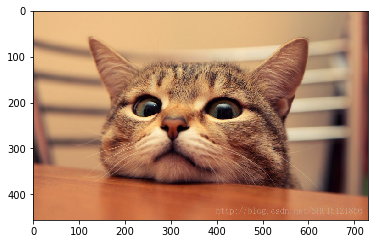

In [93]:
plt.imshow(cat)

C:\Users\softpo.DESKTOP-PN692CT\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: `imrotate` is deprecated!
`imrotate` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.rotate`` instead.
  """Entry point for launching an IPython kernel.


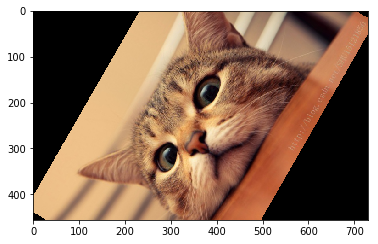

In [94]:
cat2 = misc.imrotate(cat,60)

plt.imshow(cat2)

C:\Users\softpo.DESKTOP-PN692CT\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
  """Entry point for launching an IPython kernel.


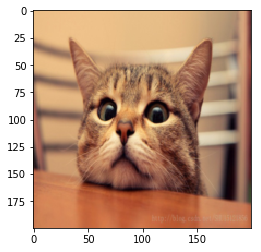

In [98]:
cat3 = misc.imresize(cat,size = (200,200))
plt.imshow(cat3)

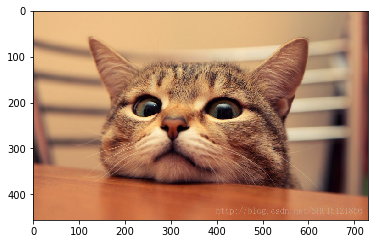

In [100]:
plt.imshow(cat)

C:\Users\softpo.DESKTOP-PN692CT\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: `imfilter` is deprecated!
`imfilter` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow filtering functionality directly.
  """


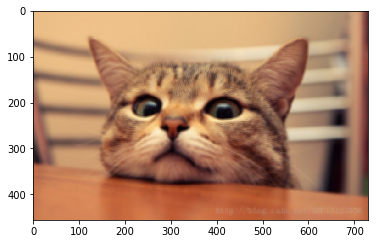

In [99]:
'''ftype : str
        The filter that has to be applied. Legal values are:
        'blur', 'contour', 'detail', 'edge_enhance', 'edge_enhance_more',
        'emboss', 'find_edges', 'smooth', 'smooth_more', 'sharpen'.'''
cat4 = misc.imfilter(cat,ftype='blur')
plt.imshow(cat4)

C:\Users\softpo.DESKTOP-PN692CT\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: `imfilter` is deprecated!
`imfilter` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow filtering functionality directly.
  """


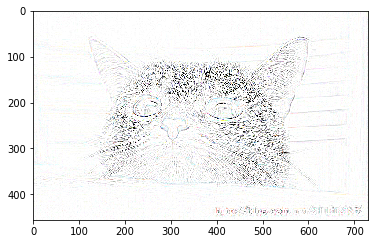

In [101]:
'''ftype : str
        The filter that has to be applied. Legal values are:
        'blur', 'contour', 'detail', 'edge_enhance', 'edge_enhance_more',
        'emboss', 'find_edges', 'smooth', 'smooth_more', 'sharpen'.'''
cat4 = misc.imfilter(cat,ftype='contour')
plt.imshow(cat4)

C:\Users\softpo.DESKTOP-PN692CT\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: `imfilter` is deprecated!
`imfilter` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use Pillow filtering functionality directly.
  """


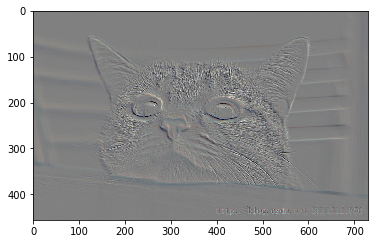

In [102]:
'''ftype : str
        The filter that has to be applied. Legal values are:
        'blur', 'contour', 'detail', 'edge_enhance', 'edge_enhance_more',
        'emboss', 'find_edges', 'smooth', 'smooth_more', 'sharpen'.'''
cat4 = misc.imfilter(cat,ftype='emboss')
plt.imshow(cat4)

In [ ]:
# ffmpeg 图像、声音、视频（图像和声音的组合）、金融领域、

In [ ]:
# ffmpeg可以将视频格式进行格式转换

In [111]:
# 从视频中提取音频
cmd = 'ffmpeg -i 1.mp4 -f mp3 -vn 2.mp3'


# 可以在代码中执行指令
import subprocess

subprocess.call(cmd)

0

In [ ]:
#截取视频
cmd = 'ffmpeg -ss 00:00:07 -i law.mp4 -acodec copy -vcodec copy -t 00:01:30 output.mp4'

subprocess.call(cmd)

In [ ]:
# 只提取视频，过滤声音
cmd = 'ffmpeg -i law.mp4 -vcodec copy -an 3.mp4'
subprocess.call(cmd)

In [ ]:
# 无声视频和声音进行合并
cmd = 'ffmpeg -i 2.mp3  -i 3.mp4 compine.mp4'

subprocess.call(cmd)

In [11]:
import matplotlib.pyplot as plt
%matplotlib inline

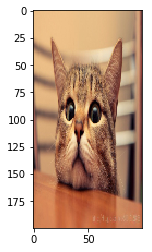

In [14]:
cat = plt.imread('./cat.jpg')

cat2 = cv2.resize(cat,(100,200))
plt.imshow(cat2)

In [15]:
import time

In [16]:
time.sleep(0.5)

In [17]:
1/24

0.041666666666666664

In [18]:
# opencv 打开一个视频
# 展示
# 3.mp4 视频，每一帧  数据获取
import time
import numpy as np
import cv2

# cv2 计算机视觉
cap = cv2.VideoCapture('./3.mp4')
i  =  0
while(cap.isOpened()):
    ret, frame = cap.read()
#     try :
# #         黑白的图片你
#         frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
#     except Exception as e:
#         print(e)
#         break
    frame = cv2.resize(frame,(200,150))
    try:
        cv2.imshow('law',frame)
    except Exception as e:
        pass
#     print(type(frame_gray) ,frame_gray.shape)
    i+=1
#     用户输入q，程序退出
    time.sleep(0.04)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# 释放资源你
cap.release()
cv2.destroyAllWindows()

In [7]:
ord('q')

113

In [6]:
2**8-1

255

In [ ]:
# 二进制 255 = 11111111

In [5]:
0xFF

255

In [8]:
ord('q')&0xFF

113

In [3]:
print(i)

3385


In [4]:
3385/141

24.00709219858156

In [ ]:
141

### 图片处理

In [19]:
from scipy import ndimage

使用scipy.misc.face(gray=True)获取图片，使用ndimage移动坐标、旋转图片、切割图片、缩放图片

导包，读取图片显示图片

In [21]:
import scipy.misc as misc

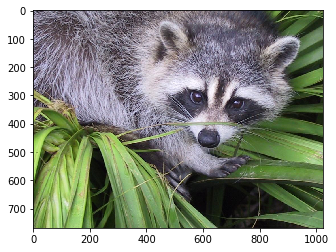

In [46]:
face = misc.face(gray = False)
# display(face)
plt.imshow(face,cmap = 'gray')

shift移动坐标

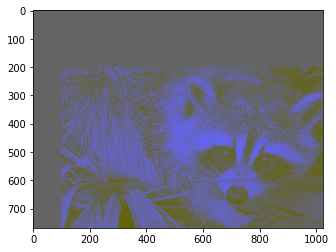

In [53]:
# RuntimeError: sequence argument must have length equal to input rank
face2 = ndimage.shift(face,shift = [200,100,2],cval=100)
plt.imshow(face2,cmap = 'gray')

In [54]:
face2

array([[[100, 100, 100],
        [100, 100, 100],
        [100, 100, 100],
        ...,
        [100, 100, 100],
        [100, 100, 100],
        [100, 100, 100]],

       [[100, 100, 100],
        [100, 100, 100],
        [100, 100, 100],
        ...,
        [100, 100, 100],
        [100, 100, 100],
        [100, 100, 100]],

       [[100, 100, 100],
        [100, 100, 100],
        [100, 100, 100],
        ...,
        [100, 100, 100],
        [100, 100, 100],
        [100, 100, 100]],

       ...,

       [[100, 100, 100],
        [100, 100, 100],
        [100, 100, 100],
        ...,
        [100, 100, 103],
        [100, 100, 100],
        [100, 100,  99]],

       [[100, 100, 100],
        [100, 100, 100],
        [100, 100, 100],
        ...,
        [100, 100, 100],
        [100, 100,  95],
        [100, 100,  95]],

       [[100, 100, 100],
        [100, 100, 100],
        [100, 100, 100],
        ...,
        [100, 100, 101],
        [100, 100, 103],
        [100, 100, 101]]

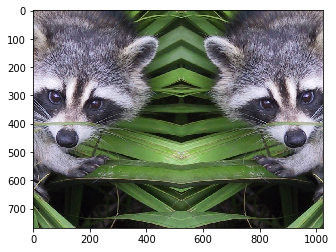

In [57]:
'''mode : {'reflect', 'constant', 'nearest', 'mirror', 'wrap'}, optional
    The `mode` parameter determines how the input array is extended
    when the filter overlaps a border. Default is 'reflect'. Behavior
    for each valid value is as follows:'''

# wrap 使用移出去数据填充空白的内容
face3 = ndimage.shift(face,shift=[0,-500,0],mode = 'mirror')
plt.imshow(face3,cmap = 'gray')

rotate旋转图片

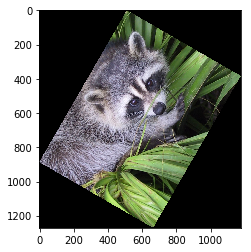

In [58]:
face4 = ndimage.rotate(face,60)
plt.imshow(face4,cmap = 'gray')

zoom缩放图片

In [40]:
face.shape

(768, 1024)

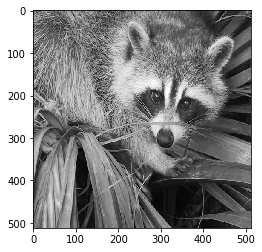

In [65]:
face5 = ndimage.zoom(face,zoom = [512/768,512/1024,1/3])
plt.imshow(face5.reshape(512,512),cmap = 'gray')
# face5

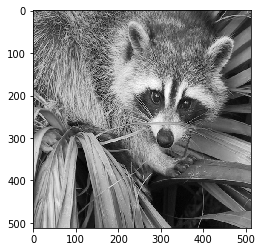

In [43]:
'''zoom : float or sequence
    The zoom factor along the axes. If a float, `zoom` is the same for each
    axis. If a sequence, `zoom` should contain one value for each axis.'''
face5 = ndimage.zoom(face,zoom = [512/768,512/1024])
plt.imshow(face5,cmap = 'gray')

切割图片

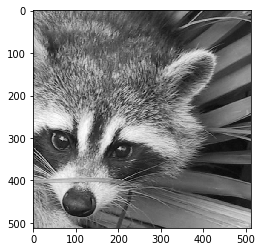

In [44]:
face6 = face[:512,-512:]
plt.imshow(face6,cmap = 'gray')

图片进行过滤   
添加噪声，对噪声图片使用ndimage中的高斯滤波、中值滤波、signal中维纳滤波进行处理  
使图片变清楚

In [74]:
moon

array([[0.04705882, 0.        , 0.23921569, ..., 0.        , 0.00392157,
        0.53333336],
       [0.        , 0.        , 0.6784314 , ..., 0.10196079, 0.2901961 ,
        0.        ],
       [0.72156864, 0.10980392, 0.6039216 , ..., 0.        , 0.21568628,
        1.        ],
       ...,
       [0.00392157, 0.        , 1.        , ..., 1.        , 1.        ,
        0.95686275],
       [0.        , 0.        , 0.15686275, ..., 0.        , 0.        ,
        0.3529412 ],
       [1.        , 0.52156866, 0.04705882, ..., 0.        , 0.        ,
        1.        ]], dtype=float32)

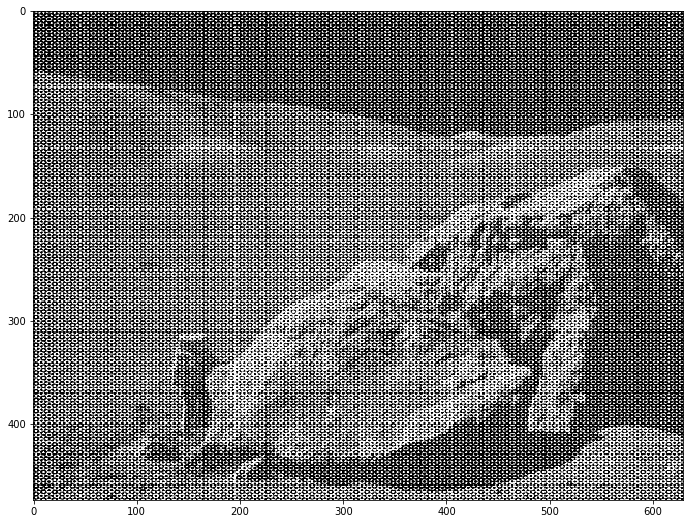

In [79]:
moon = plt.imread('./moonlanding.png')
plt.figure(figsize=(12,9))
plt.imshow(moon,cmap = 'gray')

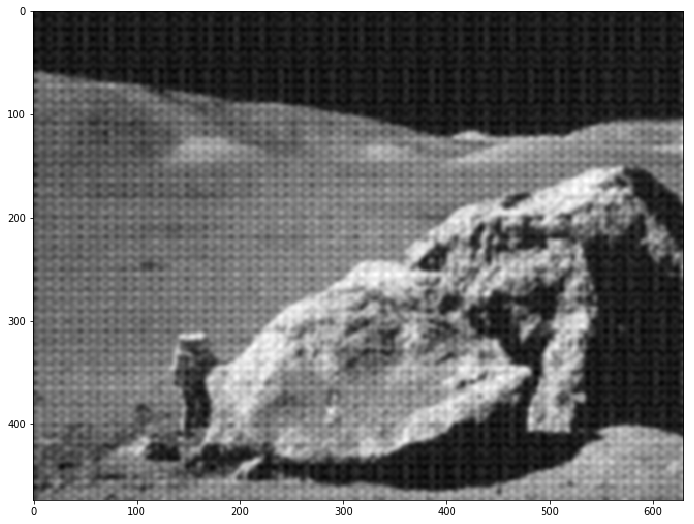

In [69]:
# sigma 高斯核，表示离散程度
# 正太分布又叫高斯分布
moon2 = ndimage.gaussian_filter(moon,sigma=2)

plt.figure(figsize=(12,9))
plt.imshow(moon2,cmap = 'gray')

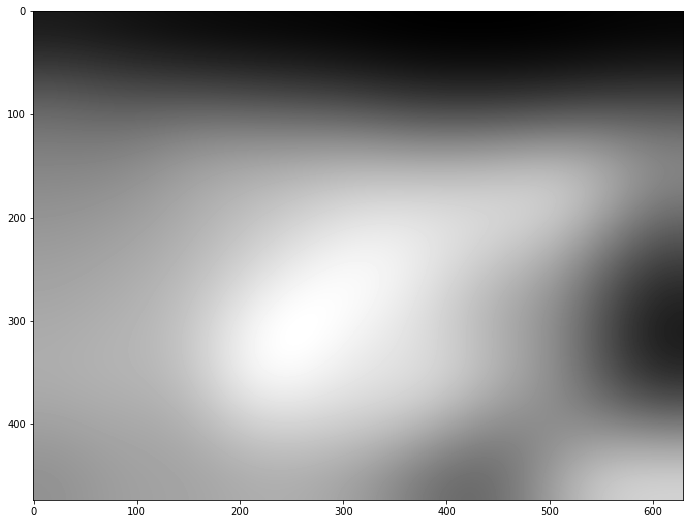

In [70]:
# sigma 高斯核，表示离散程度
# 正太分布又叫高斯分布
# 一张自然图片，平滑，连贯
moon2 = ndimage.gaussian_filter(moon,sigma=50)

plt.figure(figsize=(12,9))
plt.imshow(moon2,cmap = 'gray')

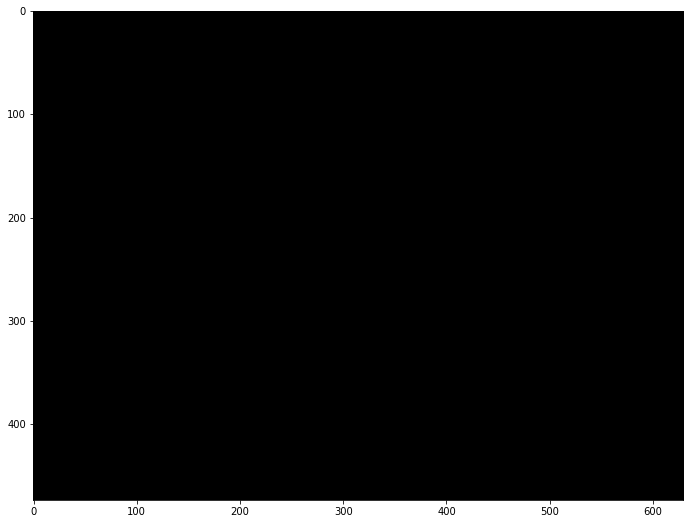

In [76]:
moon[:,:] = moon.mean()

plt.figure(figsize=(12,9))
plt.imshow(moon,cmap = 'gray')

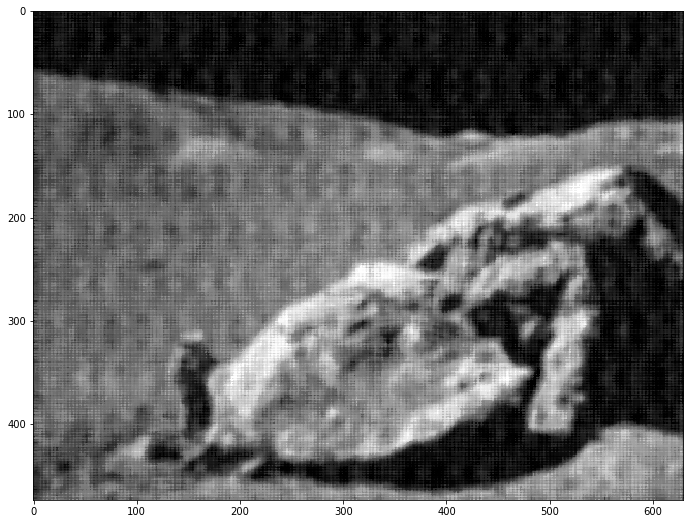

In [73]:
moon3 = ndimage.median_filter(moon,size = 10)
plt.figure(figsize=(12,9))
plt.imshow(moon3,cmap = 'gray')

加载图片，使用灰色图片misc.face()添加噪声

高斯滤波sigma：高斯核的标准偏差

中值滤波参数size：给出在每个元素上从输入数组中取出的形状位置，定义过滤器功能的输入

signal维纳滤波mysize：滤镜尺寸的标量

In [78]:
import scipy.signal as signal

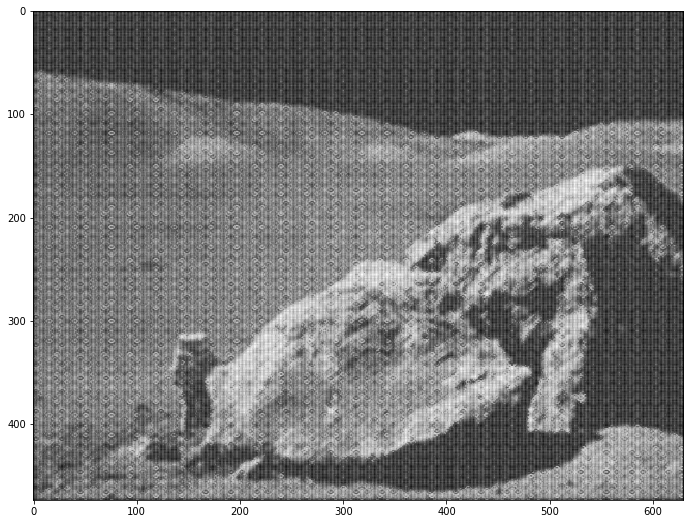

In [81]:
moon4 = signal.wiener(moon,mysize = 5)
plt.figure(figsize=(12,9))
plt.imshow(moon4,cmap = 'gray')